In [3]:
%run gather_data.ipynb

print("Twitter dataframe: ", df_twitter.head())
print("Prediction dataframe: ", df_predict.head())
print("Api dataframe: ", df_api.head())

Twitter dataframe:               tweet_id  in_reply_to_status_id  in_reply_to_user_id  \
0  892420643555336193                    NaN                  NaN   
1  892177421306343426                    NaN                  NaN   
2  891815181378084864                    NaN                  NaN   
3  891689557279858688                    NaN                  NaN   
4  891327558926688256                    NaN                  NaN   

                   timestamp  \
0  2017-08-01 16:23:56 +0000   
1  2017-08-01 00:17:27 +0000   
2  2017-07-31 00:18:03 +0000   
3  2017-07-30 15:58:51 +0000   
4  2017-07-29 16:00:24 +0000   

                                              source  \
0  <a href="http://twitter.com/download/iphone" r...   
1  <a href="http://twitter.com/download/iphone" r...   
2  <a href="http://twitter.com/download/iphone" r...   
3  <a href="http://twitter.com/download/iphone" r...   
4  <a href="http://twitter.com/download/iphone" r...   

                                   

## Data Assessment

Now we are going to look for issues with the quality or the tidiness of the data and its dimensions.

#### df_twitter

Let's first look for missing data.

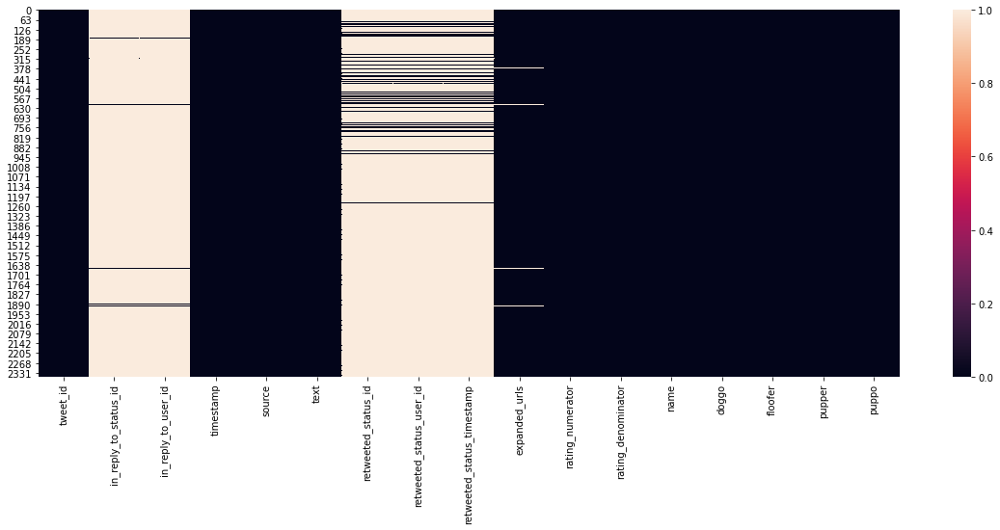

In [4]:
fig, ax = plt.subplots(figsize=(20, 7))
ax = sns.heatmap(df_twitter.isnull(), vmin=0, vmax=1)

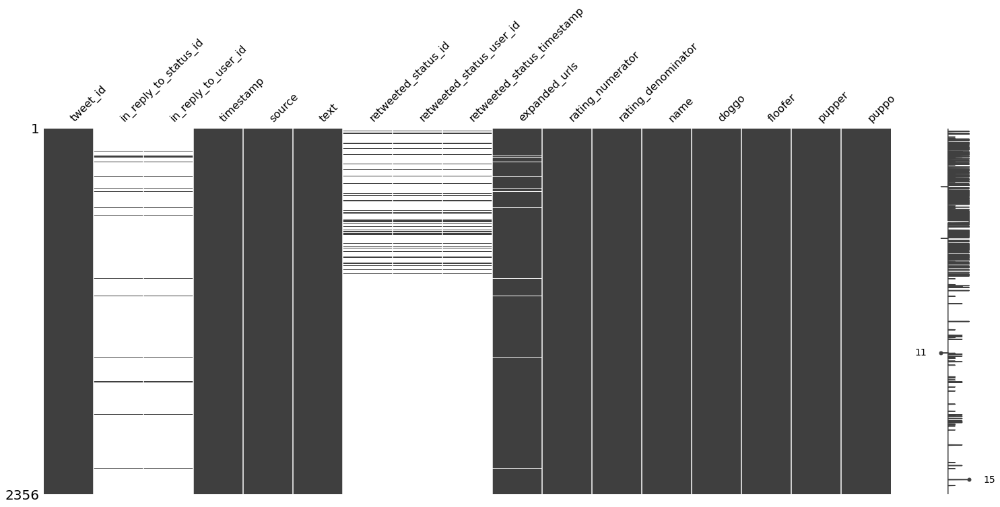

In [5]:
ms.matrix(df_twitter)

As we can see, there is a lot of missing data in the columns about the reply and the retweeted status. Since we only want original posts with images, we have to drop them later - the missing data in the "expanded_urls" column will also disappear with the cleaning operation. The matrix does show a little more detail here than the chart.

In [6]:
df_twitter.sample(5)

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
1155,724983749226668032,NaN,NaN,2016-04-26 15:29:30 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Fred-Rick. He dabbles in parkour. The ...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/724983749...,12,10,Fred,None,None,None,None
193,855459453768019968,NaN,NaN,2017-04-21 16:33:22 +0000,"<a href=""http://twitter.com/download/iphone"" r...","Guys, we only rate dogs. This is quite clearly...",NaN,NaN,NaN,https://twitter.com/dog_rates/status/855459453...,12,10,quite,None,None,None,None
197,854482394044301312,NaN,NaN,2017-04-18 23:50:52 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Arya. She can barely contain her excit...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/854482394...,13,10,Arya,None,None,None,None
330,833124694597443584,NaN,NaN,2017-02-19 01:23:00 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Gidget. She's a spy pupper. Stealthy a...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/833124694...,12,10,Gidget,None,None,pupper,None
220,850019790995546112,NaN,NaN,2017-04-06 16:18:05 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Say hello to Boomer. He's a sandy pupper. Havi...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/850019790...,12,10,Boomer,None,None,pupper,None


During the visual assessment we can observe that:

Not all tweets could be classified as doggo, floofer, pupper or puppo and all columns contain "None"
The source contains unnecessary HTML code
There is the name "None" in the name column

In [7]:
df_twitter.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2356 entries, 0 to 2355
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   tweet_id                    2356 non-null   int64  
 1   in_reply_to_status_id       78 non-null     float64
 2   in_reply_to_user_id         78 non-null     float64
 3   timestamp                   2356 non-null   object 
 4   source                      2356 non-null   object 
 5   text                        2356 non-null   object 
 6   retweeted_status_id         181 non-null    float64
 7   retweeted_status_user_id    181 non-null    float64
 8   retweeted_status_timestamp  181 non-null    object 
 9   expanded_urls               2297 non-null   object 
 10  rating_numerator            2356 non-null   int64  
 11  rating_denominator          2356 non-null   int64  
 12  name                        2356 non-null   object 
 13  doggo                       2356 

Also the datatypes are incorrect:
- tweet_id should be a str
- timestamp - columns should be datetime objects

Now let's see how many wrong names we can find.

In [8]:
df_twitter.name.value_counts()

None       745
a           55
Charlie     12
Cooper      11
Lucy        11
          ... 
Eriq         1
my           1
BeBe         1
Noah         1
Gin          1
Name: name, Length: 957, dtype: int64

As we can see, the name column contains wrong names like "None", "a", "the", "an".

In [9]:
df_twitter[df_twitter.duplicated()]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo


There are no duplicates in this data, so the number of unique tweet_ids should be the length of the df.

In [10]:
df_twitter.tweet_id.nunique()

2356

Proof. Now let's create a copy of the twitter dataframe for further assessing. I want to see in how many cases there were no classification of dog_size possible via text processing.

In [11]:
df_twitter_assess = df_twitter.copy()

In [12]:
# returns true if there is no dog classification in any of the columns
df_twitter_assess[["doggo", "floofer", "pupper", "puppo"]].apply(lambda x: True if
                                                                 (x[0] == "None" and x[1] == "None" and x[2]
                                                                  == "None" and x[3] == "None")
                                                                 else False, axis=1).value_counts()

True     1976
False     380
dtype: int64

In [13]:
df_twitter_assess["doggo"].value_counts()

None     2259
doggo      97
Name: doggo, dtype: int64

In [14]:
df_twitter_assess["floofer"].value_counts()

None       2346
floofer      10
Name: floofer, dtype: int64

In [15]:
df_twitter_assess["pupper"].value_counts()

None      2099
pupper     257
Name: pupper, dtype: int64

In [16]:
df_twitter_assess["puppo"].value_counts()

None     2326
puppo      30
Name: puppo, dtype: int64

Only for 16% of the rows the data is not missing. Now let's take a look at the ratings. By what we have seen so far, it looks like the ratings have always a format of 13/10 or 12/10 and so on. So we would expect a numerator > 10 and denominator = 10.

In [17]:
df_twitter.rating_numerator.value_counts()

12      558
11      464
10      461
13      351
9       158
8       102
7        55
14       54
5        37
6        32
3        19
4        17
1         9
2         9
420       2
0         2
15        2
75        2
80        1
20        1
24        1
26        1
44        1
50        1
60        1
165       1
84        1
88        1
144       1
182       1
143       1
666       1
960       1
1776      1
17        1
27        1
45        1
99        1
121       1
204       1
Name: rating_numerator, dtype: int64

We can observe that there is a wide range of numbers as rating_numerator, with a maximum of 1776.

In [18]:
print(df_twitter.query("rating_numerator == '1776'").text)

979    This is Atticus. He's quite simply America af....
Name: text, dtype: object


This rating is correct - so a lot higher values as 12 or 13 would be valid to this rating system. But what is with the very small ones?

In [19]:
print(df_twitter.query("rating_numerator == '1'").text)

605     RT @dog_rates: Not familiar with this breed. N...
1446    After reading the comments I may have overesti...
1869    What kind of person sends in a picture without...
1940    The millennials have spoken and we've decided ...
2038    After 22 minutes of careful deliberation this ...
2091    Flamboyant pup here. Probably poisonous. Won't...
2261    Never seen dog like this. Breathes heavy. Tilt...
2335    This is an Albanian 3 1/2 legged  Episcopalian...
2338    Not familiar with this breed. No tail (weird)....
Name: text, dtype: object


The entry 605 shows, that these tweets contain pictures that don't contain any dogs. Also in the entry 2335 the rating got extracted wrongly (misinterpreted the 1/2 of 3 1/2 as the rating).

In [20]:
print(df_twitter.query("rating_numerator == '0'").text)

315     When you're so blinded by your systematic plag...
1016    PUPDATE: can't see any. Even if I could, I cou...
Name: text, dtype: object


No clear doggo photos again. Let's make the same check for the denominator.

In [21]:
df_twitter.rating_denominator.value_counts()

10     2333
11        3
50        3
80        2
20        2
2         1
16        1
40        1
70        1
15        1
90        1
110       1
120       1
130       1
150       1
170       1
7         1
0         1
Name: rating_denominator, dtype: int64

In [22]:
print(df_twitter.query("rating_denominator == '170'").text)

1120    Say hello to this unbelievably well behaved sq...
Name: text, dtype: object


In [23]:
print(df_twitter.query("rating_denominator == '0'").text)

313    @jonnysun @Lin_Manuel ok jomny I know you're e...
Name: text, dtype: object


In [24]:
print(df_twitter.query("rating_denominator == '7'").text)

516    Meet Sam. She smiles 24/7 &amp; secretly aspir...
Name: text, dtype: object


The same problems as for the numerator. Multiple Dogs or multiple occurences of the pattern `\d+/\d+`. Lets extract this and see what we get.

In [25]:
# we could expect an integer rating on what we saw, but maybe some floats are the case
pattern = "(\d+(\.\d+)?\/\d+(\.\d+)?)"

df_twitter_assess["rating"] = df_twitter_assess.text.str.extract(
    pattern, expand=True)[0]

df_twitter_assess[['num', 'denom']] = df_twitter_assess['rating'].str.split(
    '/', n=1, expand=True)

df_twitter_assess.rating_numerator = df_twitter_assess.rating_numerator.astype(
    "str")
df_twitter_assess.rating_denominator = df_twitter_assess.rating_denominator.astype(
    "str")

# look for differences in the original numerator and the newe extract
df_twitter_assess["check_num"] = df_twitter_assess[["rating_numerator", "num"]].apply(
    lambda x: False if (x[0] != x[1]) else True, axis=1)

In [26]:
df_twitter_assess.check_num.value_counts()

True     2349
False       7
Name: check_num, dtype: int64

In [27]:
df_twitter_assess.query("check_num == False")[
    ["rating_numerator", "num", "check_num"]]

,rating_numerator,num,check_num
45,5,13.5,False
340,75,9.75,False
387,7,007,False
695,75,9.75,False
763,27,11.27,False
1689,5,9.5,False
1712,26,11.26,False


These are the differences we found by extracting the first occurrence of the pattern. These ratings got transformed to integers and are therefore wrong.

In [28]:
df_twitter_assess[["rating_numerator", "num", "check_num"]].sample(15)

,rating_numerator,num,check_num
208,13,13,True
20,12,12,True
1954,10,10,True
1623,11,11,True
787,10,10,True
285,15,15,True
1843,88,88,True
1243,10,10,True
1764,2,2,True
1979,5,5,True


Let's repeat this for the denominator.

In [29]:
df_twitter_assess["check_denom"] = df_twitter_assess[["rating_denominator", "denom"]].apply(
    lambda x: False if (x[0] != x[1]) else True, axis=1)

df_twitter_assess.check_denom.value_counts()

True     2355
False       1
Name: check_denom, dtype: int64

In [30]:
df_twitter_assess.query("check_denom == False")[
    ["rating_denominator", "denom", "check_denom"]]  # problem with integer, maybe also floats?

,rating_denominator,denom,check_denom
313,0,00,False


This seems like something we don't have to worry about.

In [31]:
df_twitter_assess[["rating_denominator", "denom", "check_denom"]].sample(5)

,rating_denominator,denom,check_denom
490,10,10,True
1737,10,10,True
2269,10,10,True
299,10,10,True
1302,10,10,True


Now we should assess how often there are multiple occurrences of the "rating pattern" in one tweet clear

In [32]:
df_twitter_assess["count"] = df_twitter_assess.text.str.count(pattern)

In [33]:
df_twitter_assess["count"].value_counts()

1    2323
2      32
3       1
Name: count, dtype: int64

In [34]:
# show the full text
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_colwidth', 4000)

df_twitter_assess[["text", "count"]].query("count != 1")

,text,count
55,@roushfenway These are good dogs but 17/10 is an emotional impulse rating. More like 13/10s,2
313,"@jonnysun @Lin_Manuel ok jomny I know you're excited but 960/00 isn't a valid rating, 13/10 is tho",2
561,"RT @dog_rates: ""Yep... just as I suspected. You're not flossing."" 12/10 and 11/10 for the pup not flossing https://t.co/SuXcI9B7pQ",2
766,"""Yep... just as I suspected. You're not flossing."" 12/10 and 11/10 for the pup not flossing https://t.co/SuXcI9B7pQ",2
784,"RT @dog_rates: After so many requests, this is Bretagne. She was the last surviving 9/11 search dog, and our second ever 14/10. RIP https:/…",2
860,RT @dog_rates: Meet Eve. She's a raging alcoholic 8/10 (would b 11/10 but pupper alcoholism is a tragic issue that I can't condone) https:/…,2
1007,This is Bookstore and Seaweed. Bookstore is tired and Seaweed is an asshole. 10/10 and 7/10 respectively https://t.co/eUGjGjjFVJ,2
1068,"After so many requests, this is Bretagne. She was the last surviving 9/11 search dog, and our second ever 14/10. RIP https://t.co/XAVDNDaVgQ",2
1165,Happy 4/20 from the squad! 13/10 for all https://t.co/eV1diwds8a,2
1202,This is Bluebert. He just saw that both #FinalFur match ups are split 50/50. Amazed af. 11/10 https://t.co/Kky1DPG4iq,2


We can see that:
- This data contains retweets (as mentioned before)
- Sometimes there are multiple dogs/cats or else in one picture
- Some of these ratings are not clear

#### df_predict

Let's also begin with the missing data first.

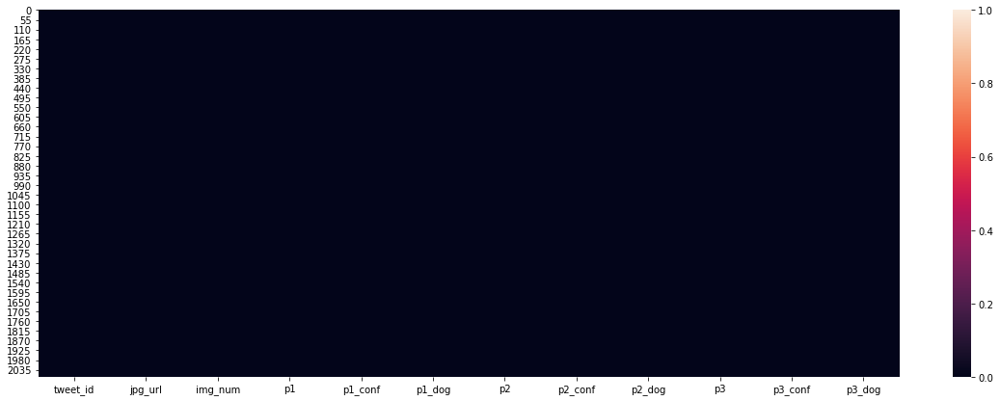

In [35]:
fig, ax = plt.subplots(figsize=(20, 7))
ax = sns.heatmap(df_predict.isnull(), vmin=0, vmax=1)

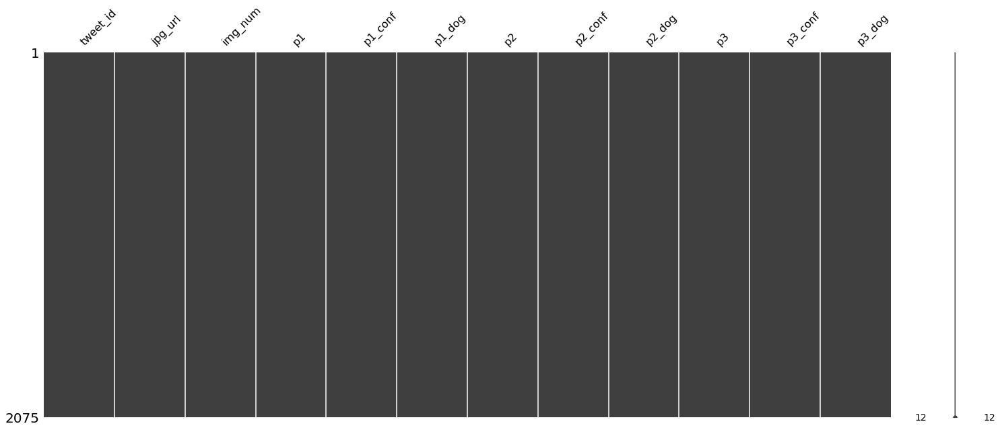

In [36]:
ms.matrix(df_predict)

Looks fine. Now the visual assessment:

In [37]:
df_predict.sample(10)

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
1006,709158332880297985,https://pbs.twimg.com/media/CddvvSwWoAUObQw.jpg,1,Siberian_husky,0.212957,True,Eskimo_dog,0.178887,True,Labrador_retriever,0.174218,True
1383,765669560888528897,https://pbs.twimg.com/media/CqA0XcYWAAAzltT.jpg,1,beagle,0.993333,True,Walker_hound,0.002902,True,basset,0.002415,True
948,704819833553219584,https://pbs.twimg.com/media/CcgF5ovW8AACrEU.jpg,1,guinea_pig,0.994776,False,hamster,0.004069,False,wood_rabbit,0.000206,False
1283,750429297815552001,https://pbs.twimg.com/media/CmoPdmHW8AAi8BI.jpg,1,golden_retriever,0.964929,True,Labrador_retriever,0.011584,True,refrigerator,0.007499,False
830,693629975228977152,https://pbs.twimg.com/media/CaBEx3SWEAILZpi.jpg,1,pug,0.841987,True,French_bulldog,0.069791,True,Boston_bull,0.038720,True
1100,720775346191278080,https://pbs.twimg.com/media/CgC1WqMW4AI1_N0.jpg,1,Newfoundland,0.489970,True,groenendael,0.174497,True,giant_schnauzer,0.079067,True
1204,741743634094141440,https://pbs.twimg.com/media/Cksz42EW0AAh2NF.jpg,1,Labrador_retriever,0.786089,True,flat-coated_retriever,0.048652,True,Chesapeake_Bay_retriever,0.034693,True
1552,793150605191548928,https://pbs.twimg.com/media/CwHWOZ7W8AAHv8S.jpg,1,Italian_greyhound,0.193869,True,bluetick,0.160380,True,standard_poodle,0.125982,True
661,682429480204398592,https://pbs.twimg.com/media/CXh5_dDWQAIbU-J.jpg,1,whippet,0.594701,True,Italian_greyhound,0.314091,True,Mexican_hairless,0.037773,True
120,668190681446379520,https://pbs.twimg.com/media/CUXj4SgXAAETlu6.jpg,1,Blenheim_spaniel,0.958402,True,cocker_spaniel,0.026764,True,Welsh_springer_spaniel,0.007790,True


We can see that:
- The predicitions are sometimes lowercase, sometimes uppercase
- There is an underscore instead of a whitespace between the words
- There are rows with no prediciton of a dog (neither in 1, 2 nor 3)

In [38]:
df_predict.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2075 entries, 0 to 2074
Data columns (total 12 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   tweet_id  2075 non-null   int64  
 1   jpg_url   2075 non-null   object 
 2   img_num   2075 non-null   int64  
 3   p1        2075 non-null   object 
 4   p1_conf   2075 non-null   float64
 5   p1_dog    2075 non-null   bool   
 6   p2        2075 non-null   object 
 7   p2_conf   2075 non-null   float64
 8   p2_dog    2075 non-null   bool   
 9   p3        2075 non-null   object 
 10  p3_conf   2075 non-null   float64
 11  p3_dog    2075 non-null   bool   
dtypes: bool(3), float64(3), int64(2), object(4)
memory usage: 152.1+ KB


The tweet_id column should again be string

The best way to find duplicates is to look at the jpg - url. If there are value counts > 1, then this data contains duplicates/retweets.

In [39]:
df_predict.jpg_url.value_counts().head(10)

https://pbs.twimg.com/media/CU3mITUWIAAfyQS.jpg                                            2
https://pbs.twimg.com/media/CYLDikFWEAAIy1y.jpg                                            2
https://pbs.twimg.com/media/CpmyNumW8AAAJGj.jpg                                            2
https://pbs.twimg.com/media/C2kzTGxWEAEOpPL.jpg                                            2
https://pbs.twimg.com/media/C2oRbOuWEAAbVSl.jpg                                            2
https://pbs.twimg.com/ext_tw_video_thumb/807106774843039744/pu/img/8XZg1xW35Xp2J6JW.jpg    2
https://pbs.twimg.com/media/CwiuEJmW8AAZnit.jpg                                            2
https://pbs.twimg.com/media/C4KHj-nWQAA3poV.jpg                                            2
https://pbs.twimg.com/media/CsGnz64WYAEIDHJ.jpg                                            2
https://pbs.twimg.com/media/Cbs3DOAXIAAp3Bd.jpg                                            2
Name: jpg_url, dtype: int64

As predicted - this data contains retweets.

In [40]:
df_predict[df_predict.tweet_id.duplicated()]

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog


In [41]:
df_predict[df_predict.jpg_url ==
           "https://pbs.twimg.com/media/CeRoBaxWEAABi0X.jpg"]

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
1045,712809025985978368,https://pbs.twimg.com/media/CeRoBaxWEAABi0X.jpg,1,Labrador_retriever,0.868671,True,carton,0.095095,False,pug,0.007651,True
1594,798697898615730177,https://pbs.twimg.com/media/CeRoBaxWEAABi0X.jpg,1,Labrador_retriever,0.868671,True,carton,0.095095,False,pug,0.007651,True


In [42]:
df_twitter[df_twitter.tweet_id == 798697898615730177]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
596,798697898615730177,NaN,NaN,2016-11-16 01:23:12 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",RT @dog_rates: This is Stubert. He just arrived. 10/10 https://t.co/HVGs5aAKAn,7.128090e+17,4.196984e+09,2016-03-24 01:11:29 +0000,"https://twitter.com/dog_rates/status/712809025985978368/photo/1,https://twitter.com/dog_rates/status/712809025985978368/photo/1",10,10,Stubert,None,None,None,None


We only want tweets with pictures which contain dogs. Let's see if there are pictures, for which the ML - Algorithm didn't predict any dogs.

In [43]:
df_predict.query("p1_dog == False and p2_dog == False and p3_dog == False")

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
6,666051853826850816,https://pbs.twimg.com/media/CT5KoJ1WoAAJash.jpg,1,box_turtle,0.933012,False,mud_turtle,0.045885,False,terrapin,0.017885,False
17,666104133288665088,https://pbs.twimg.com/media/CT56LSZWoAAlJj2.jpg,1,hen,0.965932,False,cock,0.033919,False,partridge,0.000052,False
18,666268910803644416,https://pbs.twimg.com/media/CT8QCd1WEAADXws.jpg,1,desktop_computer,0.086502,False,desk,0.085547,False,bookcase,0.079480,False
21,666293911632134144,https://pbs.twimg.com/media/CT8mx7KW4AEQu8N.jpg,1,three-toed_sloth,0.914671,False,otter,0.015250,False,great_grey_owl,0.013207,False
25,666362758909284353,https://pbs.twimg.com/media/CT9lXGsUcAAyUFt.jpg,1,guinea_pig,0.996496,False,skunk,0.002402,False,hamster,0.000461,False
...,...,...,...,...,...,...,...,...,...,...,...,...
2021,880935762899988482,https://pbs.twimg.com/media/DDm2Z5aXUAEDS2u.jpg,1,street_sign,0.251801,False,umbrella,0.115123,False,traffic_light,0.069534,False
2022,881268444196462592,https://pbs.twimg.com/media/DDrk-f9WAAI-WQv.jpg,1,tusker,0.473303,False,Indian_elephant,0.245646,False,ibex,0.055661,False
2046,886680336477933568,https://pbs.twimg.com/media/DE4fEDzWAAAyHMM.jpg,1,convertible,0.738995,False,sports_car,0.139952,False,car_wheel,0.044173,False
2052,887517139158093824,https://pbs.twimg.com/ext_tw_video_thumb/887517108413886465/pu/img/WanJKwssZj4VJvL9.jpg,1,limousine,0.130432,False,tow_truck,0.029175,False,shopping_cart,0.026321,False


In [44]:
df_predict.query("p1_dog == False and (p2_dog == True or p3_dog == True)")

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
8,666057090499244032,https://pbs.twimg.com/media/CT5PY90WoAAQGLo.jpg,1,shopping_cart,0.962465,False,shopping_basket,0.014594,False,golden_retriever,0.007959,True
22,666337882303524864,https://pbs.twimg.com/media/CT9OwFIWEAMuRje.jpg,1,ox,0.416669,False,Newfoundland,0.278407,True,groenendael,0.102643,True
33,666430724426358785,https://pbs.twimg.com/media/CT-jNYqW4AAPi2M.jpg,1,llama,0.505184,False,Irish_terrier,0.104109,True,dingo,0.062071,False
43,666776908487630848,https://pbs.twimg.com/media/CUDeDoWUYAAD-EM.jpg,1,seat_belt,0.375057,False,miniature_pinscher,0.167175,True,Chihuahua,0.086951,True
52,666996132027977728,https://pbs.twimg.com/media/CUGlb6iUwAITEbW.jpg,1,hay,0.507637,False,Rottweiler,0.062490,True,water_buffalo,0.048425,False
...,...,...,...,...,...,...,...,...,...,...,...,...
1984,872122724285648897,https://pbs.twimg.com/media/DBpm-5UXcAUeCru.jpg,1,basketball,0.808396,False,pug,0.066736,True,dalmatian,0.054570,True
1992,873697596434513921,https://pbs.twimg.com/media/DA7iHL5U0AA1OQo.jpg,1,laptop,0.153718,False,French_bulldog,0.099984,True,printer,0.077130,False
2013,879376492567855104,https://pbs.twimg.com/media/DDQsQGFV0AAw6u9.jpg,1,tricycle,0.663601,False,Labrador_retriever,0.033496,True,Pembroke,0.018827,True
2026,882045870035918850,https://pbs.twimg.com/media/DD2oCl2WAAEI_4a.jpg,1,web_site,0.949591,False,dhole,0.017326,False,golden_retriever,0.006941,True


After checking some of these pictures it gets clear, that sometimes the doggos are in the background or the pictures doesn't contain any dogs at all.

#### df_api

Lets repeat the same pattern for this dataset: missing data and then visual assessment.

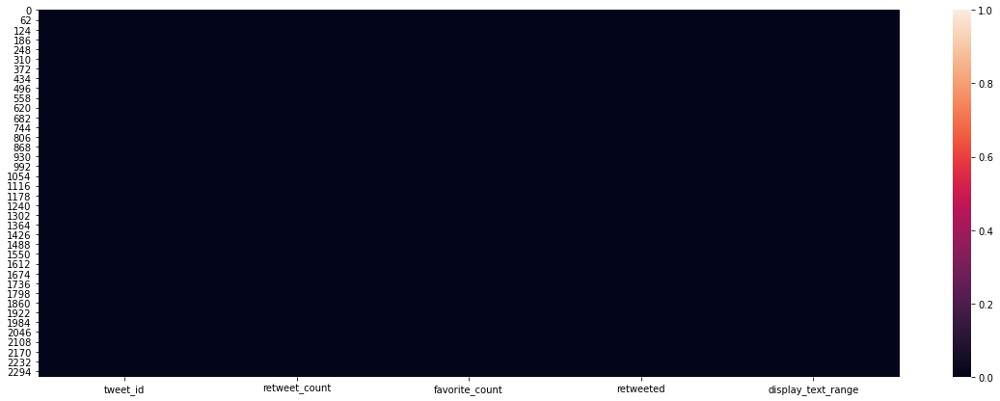

In [45]:
fig, ax = plt.subplots(figsize=(20, 7))
ax = sns.heatmap(df_api.isnull(), vmin=0, vmax=1)

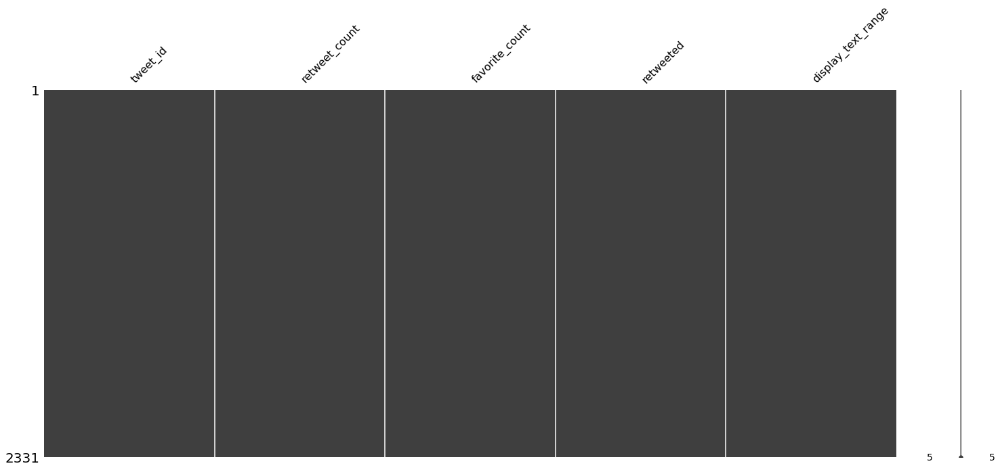

In [46]:
ms.matrix(df_api)

In [47]:
df_api.sample(10)

,tweet_id,retweet_count,favorite_count,retweeted,display_text_range
1298,706291001778950144,475,1693,False,"[0, 130]"
59,880465832366813184,5698,26812,False,"[0, 114]"
372,826598365270007810,2377,10168,False,"[0, 75]"
1382,699088579889332224,633,2246,False,"[0, 139]"
861,760252756032651264,879,3973,False,"[0, 116]"
2228,667793409583771648,315,678,False,"[0, 119]"
532,805207613751304193,1759,8010,False,"[0, 55]"
2311,666273097616637952,73,161,False,"[0, 46]"
279,838085839343206401,1,140,False,"[23, 63]"
852,761292947749015552,1096,4533,False,"[0, 106]"


In [48]:
df_api.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2331 entries, 0 to 2330
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   tweet_id            2331 non-null   int64 
 1   retweet_count       2331 non-null   int64 
 2   favorite_count      2331 non-null   int64 
 3   retweeted           2331 non-null   bool  
 4   display_text_range  2331 non-null   object
dtypes: bool(1), int64(3), object(1)
memory usage: 75.2+ KB


Overall it looks good for this dataset. There is no missing data - only the datatype of the tweet_id should again be a string.

### Assessment Summary

#### Quality
##### `df_twitter` table
- The datatype of the id - columns is integer and should be str
- The datatype of the timestamp - column is object and should be datetime
- Some of the dogs are not classified as one of "doggo", "floofer", "pupper" or "puppo" and contain all "None" instead
- Some of the dog names are not correct (None, an, by, a, ...)
- Contains retweets
- Some of the ratings are not correctly extracted (mostly if there are >1 entries with the pattern `(\d+(\.\d+)?\/\d+(\.\d+)?)`)
- Also transforming the ratings to integer created some mistakes (there are also floats)
- The source column contains html code

##### `df_predict` table
- The datatype of the id - columns is integer and should be str
- Contains retweets (duplicated rows in column `jpg_url`)
- There are pictures in this table that are not dogs
- The predictions are sometimes uppercase, sometimes lowercase
- Also there is a "_" instead of a whitespace in the predictions

##### `df_api` table
- The datatype of the id - columns is integer and should be str

#### Tidiness

##### `df_twitter` table
- The columns `doggo`, `floofer`,`pupper` and `puppo` are not easy to analyze and should be in one column

##### `df_predict` table
- The prediction and confidence columns should be reduced to two columns - one for the prediction with the highest confidence (dog)

##### `df_api` table
- Display_text_range contains 2 variables

##### `all` tables

- All three tables share the column `tweet_id` and should be merged together.

## Data Cleaning

Cleaning steps:

- Merge the tables together
- Drop the replies, retweets and the corresponding columns and also drop the tweets without an image or with images which don't display doggos
- Clean the datatypes of the columns
- Clean the wrong numerators - the floats on the one hand (replacement), the ones with multiple occurence of the pattern on the other (drop)
- Extract the source from html code
- Split the text range into two separate columns
- Remove the "None" out of the doggo, floofer, pupper and puppo column and merge them into one column
- Remove the wrong names of name column
- Reduce the prediction columns into two - breed and conf
- Clean the new breed column by replacing the "_" with a whitespace and make them all lowercase


#### 1. Merge the tables together

I could clean all the tables one by one, but all of them share some cleaning needs or are dependent on each other to do so (for example removing of retweets or pictures not containing dogs). By merging them all together as first step, I can save some coding time and avoid repetition. 